# Data transform 실습

## 학습목표

> `torchvision.transforms` 에서 제공하는 이미지 관련 data augmentation 들에 대한 학습한다.

**목차(context)**
> 1. Pad
> 2. Resize
> 3. CenterCrop
> 4. FiveCrop
> 5. Grayscale
> 6. Random transforms
> 7. Randomly-applied transforms

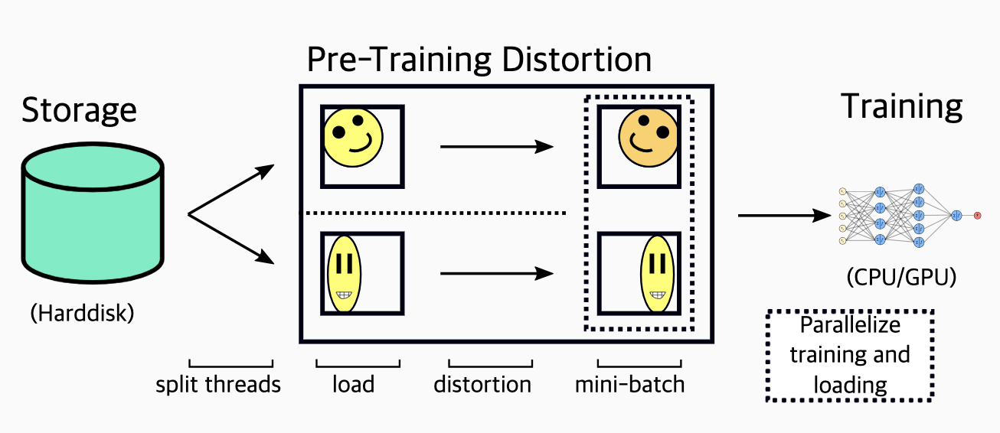

In [1]:
from PIL import Image
from pathlib import Path
import matplotlib.pyplot as plt
import numpy as np

import torch
import torchvision.transforms as T

torch.manual_seed(0)

> 우선 `cat.jpg` 파일을 업로드하고, pillow (PIL) 라이브러리를 이용해 이미지를 로드한다.

In [10]:
!wget https://www.dropbox.com/scl/fi/sljih38ypv34lqvuutjsq/cat.jpg?rlkey=ptujapdm5oax3ix7u8kvo8ykv&st=ibgkk9yi&dl=0
!mv cat.jpg?rlkey=ptujapdm5oax3ix7u8kvo8ykv cat.jpg

--2024-09-01 11:58:51--  https://www.dropbox.com/scl/fi/sljih38ypv34lqvuutjsq/cat.jpg?rlkey=ptujapdm5oax3ix7u8kvo8ykv
Resolving www.dropbox.com (www.dropbox.com)... 162.125.1.18, 2620:100:6016:18::a27d:112
Connecting to www.dropbox.com (www.dropbox.com)|162.125.1.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://uc549bbb85782818b0264b0a9ef0.dl.dropboxusercontent.com/cd/0/inline/CZv6Kt2ng8n0Q0siLVvvjudRBhalqc9wo5q3U-NOECdgRM8Z4ykRVFtdVVHzHZhAScSpo6NZgY6WM-WvZB6bAwcFvppLmKH0E_QfcR17PJa6EAixuz2C4O4P0mjH5GEs5wU8ai24yOggGCd_fFhZNSRi/file# [following]
--2024-09-01 11:58:51--  https://uc549bbb85782818b0264b0a9ef0.dl.dropboxusercontent.com/cd/0/inline/CZv6Kt2ng8n0Q0siLVvvjudRBhalqc9wo5q3U-NOECdgRM8Z4ykRVFtdVVHzHZhAScSpo6NZgY6WM-WvZB6bAwcFvppLmKH0E_QfcR17PJa6EAixuz2C4O4P0mjH5GEs5wU8ai24yOggGCd_fFhZNSRi/file
Resolving uc549bbb85782818b0264b0a9ef0.dl.dropboxusercontent.com (uc549bbb85782818b0264b0a9ef0.dl.dropboxusercontent.com)... 162.125.1.15, 2620:100:60

In [2]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


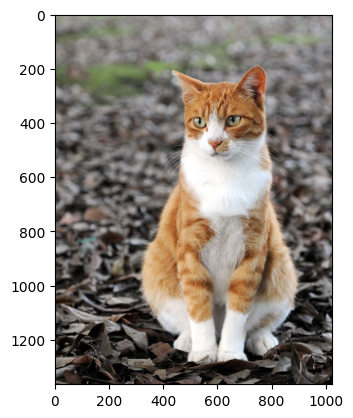

In [11]:
import os
cat_image_path = "cat.jpg"
orig_img = Image.open(cat_image_path)
plt.imshow(orig_img)

In [12]:
def plot(imgs, with_orig=True, row_title=None, **imshow_kwargs):
    if not isinstance(imgs[0], list):
        # 1 row 여도 2D grid 생성
        imgs = [imgs]

    num_rows = len(imgs)
    num_cols = len(imgs[0]) + with_orig
    fig, axs = plt.subplots(nrows=num_rows, ncols=num_cols, squeeze=False, figsize=(20,8))
    for row_idx, row in enumerate(imgs):
        row = [orig_img] + row if with_orig else row
        for col_idx, img in enumerate(row):
            ax = axs[row_idx, col_idx]
            ax.imshow(np.asarray(img), **imshow_kwargs)
            ax.set(xticklabels=[], yticklabels=[], xticks=[], yticks=[])

    if with_orig:
        axs[0, 0].set(title='Original image')
        axs[0, 0].title.set_size(8)
    if row_title is not None:
        for row_idx in range(num_rows):
            axs[row_idx, 0].set(ylabel=row_title[row_idx])

    plt.tight_layout()

## Pad
`torchvision.transforms.Pad` 또는 `torchvision.transforms.functional.pad`

> 이미지의 가장자리를 지정한 픽셀 값으로 채운다. \
> 지정하지 않을 경우 0(검정색)으로 채운다.
>
> 인자 (argument)
> - padding: 채워질 영역의 픽셀 갯수
> - fill: 채워질 픽셀 값

In [13]:
padded_imgs = [T.Pad(padding=padding)(orig_img) for padding in (3, 10, 30, 100)]
plot(padded_imgs)

Output hidden; open in https://colab.research.google.com to view.

## Resize
`torchvision.transforms.Resize` 또는 `torchvision.transforms.functional.resize`
> 이미지 사이즈를 조정한다.
>
> 인자 (argument)
>   - size: 조정할 사이즈 크기

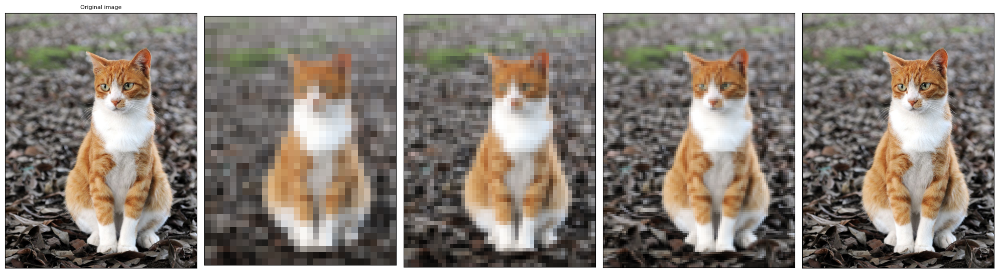

In [14]:
resized_imgs = [T.Resize(size=size)(orig_img) for size in (30, 50, 100, orig_img.size[0])]
plot(resized_imgs)

## CenterCrop
`torchvision.transforms.CenterCrop` 또는 `torchvision.transforms.functional.center_crop`
> 이미지 중심을 기준으로 주변부를 자른다.
>
> 인자 (argument)
>    - size: 자를 영역의 크기

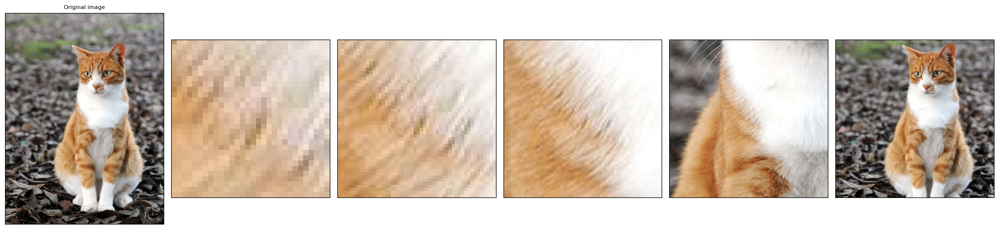

In [15]:
center_crops = [T.CenterCrop(size=size)(orig_img) for size in (30, 50, 100, 300, orig_img.size[0])]
plot(center_crops)

## FiveCrop
`torchvision.transforms.FiveCrop` 또는 `torchvision.transforms.functional.five_crop`
> 정 중앙과 네 모서리 영역을 crop 하여 반환한다.
>
> 인자 (argument)
>    - size: crop할 이미지 크기

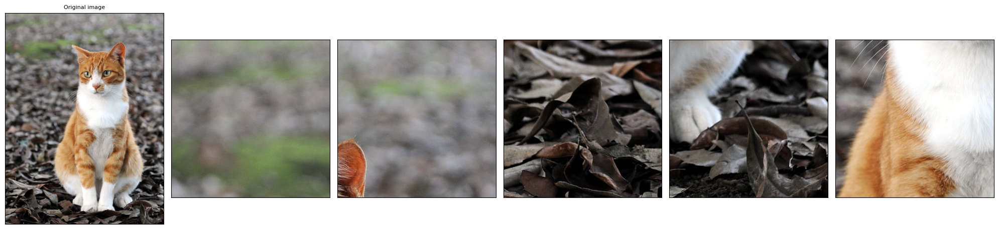

In [16]:
(top_left, top_right, bottom_left, bottom_right, center) = T.FiveCrop(size=(300, 300))(orig_img)
plot([top_left, top_right, bottom_left, bottom_right, center])

## Grayscale
`torchvision.transforms.Grayscale` 또는 `torchvision.transforms.functional.to_grayscale`
> 이미지를 흑백사진으로 변환한다.


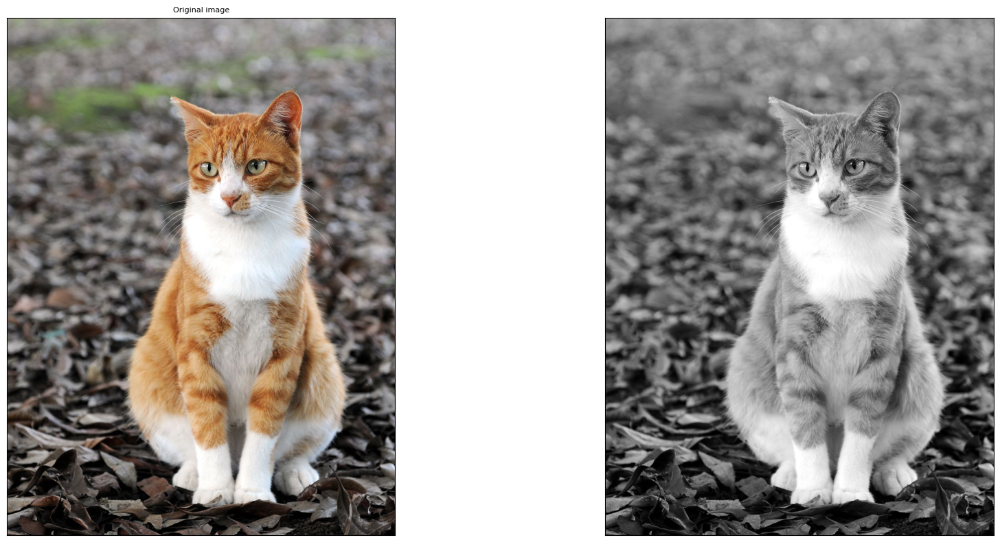

In [17]:
gray_img = T.Grayscale()(orig_img)
plot([gray_img], cmap='gray')

## Random transforms
> 아래의 transform들은 random한 연산을 통해 매번 다른 이미지를 반환한다.


### ColorJitter
`torchvision.transforms.ColorJitter`
> 이미지의 밝기, 채도 등을 랜덤하게 변환한다.
>
> 인자 (argument)
>    - brightness: 얼마나 밝기를 조절할 것인지에 대한 값. `[max(0, 1-brightness), 1+brightness)]` 에서 랜덤 샘플링\
> non negative numbers.
>    - hue: 얼마나 색을 변화시킬 것인지에 대한 값. `[-hue, hue]`에서 랜덤 샘플링 \
> Should have 0<= hue <= 0.5 or -0.5 <= min <= max <= 0.5

In [18]:
jitter = T.ColorJitter(brightness=5, hue=.3)
jitted_imgs = [jitter(orig_img) for _ in range(4)]
plot(jitted_imgs)

Output hidden; open in https://colab.research.google.com to view.

### GaussianBlur
`torchvision.transforms.GaussianBlur` 또는 `torchvision.transforms.functional.gaussian_blur`
> 이미지에 Gaussian Blur를 적용한다.\
> 이미지 노이즈 줄이고 부드러운 효과.\
> 인자 (argument)
>    - kernel_size: Gaussian 커널의 크기
>    - sigma: Gaussian 커널의 표준편차 값


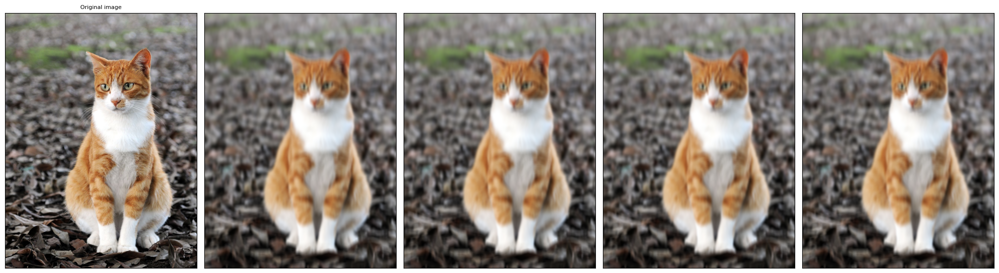

In [19]:
blurrer = T.GaussianBlur(kernel_size=(11, 31), sigma=(10, 20))
blurred_imgs = [blurrer(orig_img) for _ in range(4)]
plot(blurred_imgs)

### RandomPerspective
`torchvision.transforms.RandomPerspective` 또는 `torchvision.transforms.functional.perspective`
> Random Perspective (원근법) 변환을 적용한다.\
> 이미지의 네 모서리를 각각에 대해 무작위로 새로운 위치 선택 \
> 원본 이미지 모서리와 랜덤 픽된 네 모서리 사이 매핑을 계산해 원근 변환 적용 \
> 인자 (argument)
>    - distortion_scale: 변환을 할 정도이며 범위는 0~1.
>    - p: 변환을 적용할 확률

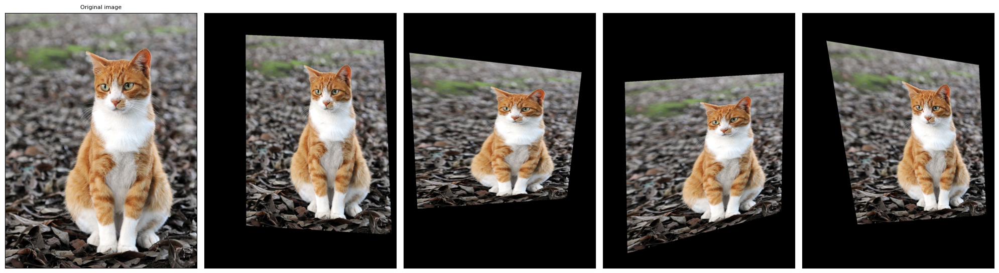

In [20]:
perspective_transformer = T.RandomPerspective(distortion_scale=0.6, p=1.0)
perspective_imgs = [perspective_transformer(orig_img) for _ in range(4)]
plot(perspective_imgs)

### RandomRotation
`torchvision.transforms.RandomRotation` 또는 `torchvision.transforms.functional.rotate`
> 이미지를 랜덤한 각도로 회전한다.\
> 이미지 중심을 기준으로 지정된 범위만큼 회전 \
> 인자 (argument)
>    - degree: 회전시킬 각도의 범위

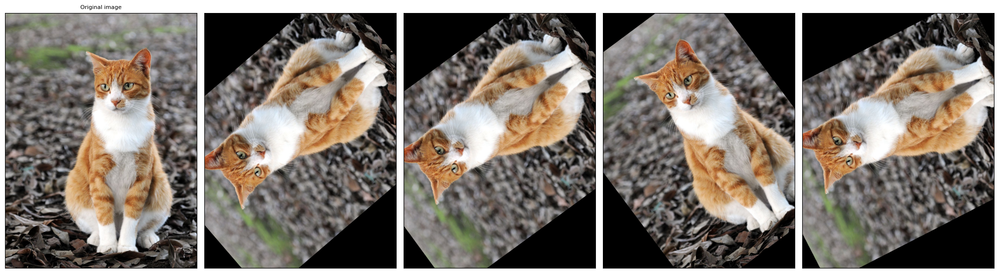

In [21]:
rotater = T.RandomRotation(degrees=(0, 180))
rotated_imgs = [rotater(orig_img) for _ in range(4)]
plot(rotated_imgs)

### RandomCrop
`torchvision.transforms.RandomCrop` 또는 `~torchvision.transforms.functional.crop`
> 이미지를 랜덤하게 자른다.
>
> 인자 (argument)
>    - size: crop할 영역의 크기

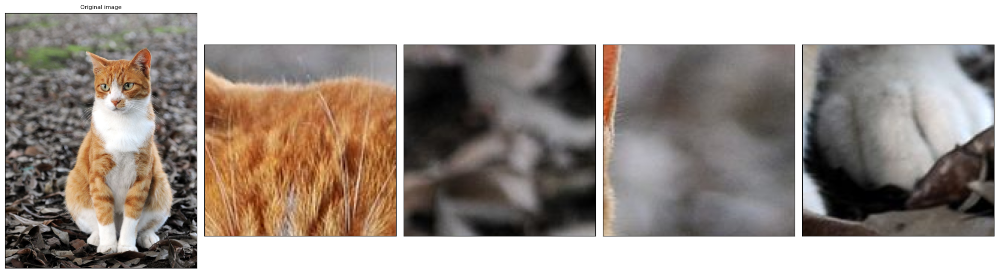

In [23]:
cropper = T.RandomCrop(size=(128, 128))
crops = [cropper(orig_img) for _ in range(4)]
plot(crops)

### RandomResizedCrop
`torchvision.transforms.RandomResizedCrop` 또는 `torchvision.transforms.functional.resized_crop`
> 이미지를 랜덤하게 crop 한 후 크기를 조정한다.
>
> 인자 (argument)
>    - size: crop할 영역의 크기
>    - scale=(0.08, 1.0)
>    - ratio=(0.75, 1.3333333333333333),

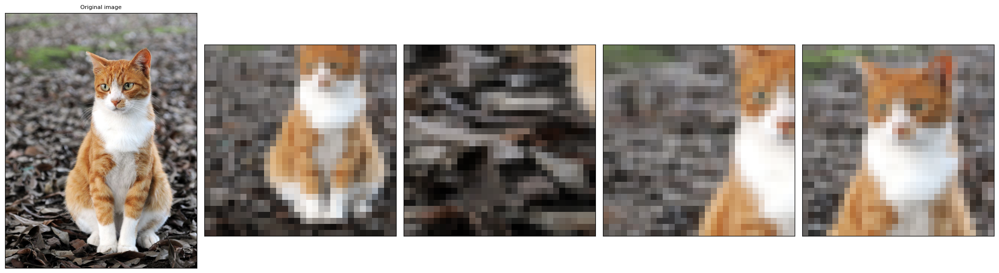

In [24]:
resize_cropper = T.RandomResizedCrop(size=(32, 32))
resized_crops = [resize_cropper(orig_img) for _ in range(4)]
plot(resized_crops)

### RandomInvert
`torchvision.transforms.RandomInvert` 또는 `torchvision.transforms.functional.invert`
> 이미지의 색상을 반전시킨다.
> 확률을 설정하지 않으면 0.5를 사용한다.
>
> 인자 (argument)
>    - p: invert를 적용할 확률


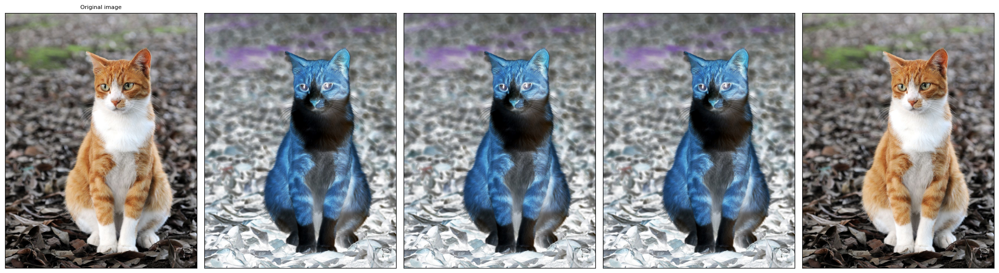

In [25]:
inverter = T.RandomInvert()
invertered_imgs = [inverter(orig_img) for _ in range(4)]
plot(invertered_imgs)

### RandomPosterize
`torchvision.transforms.RandomPosterize` 또는 `torchvision.transforms.functional.posterize`
> 이미지를 랜덤하게 posterize 한다.
> 확률을 설정하지 않으면 0.5를 사용한다.\
> 이미지 표현 가능한 색상 수 감소. 단순화 \
> 인자 (argument)
>    - bits: 각 채널에서 유지시킬 비트의 갯수
>    - p: posterize를 적용할 확률

>    0-63 → 0 (00000000)\
>    64-127 → 64 (01000000)\
>    128-191 → 128 (10000000)\
>    192-255 → 192 (11000000)

>    Original: (214, 150, 100)\
>    Posterized (2-bit): (192, 128, 64)

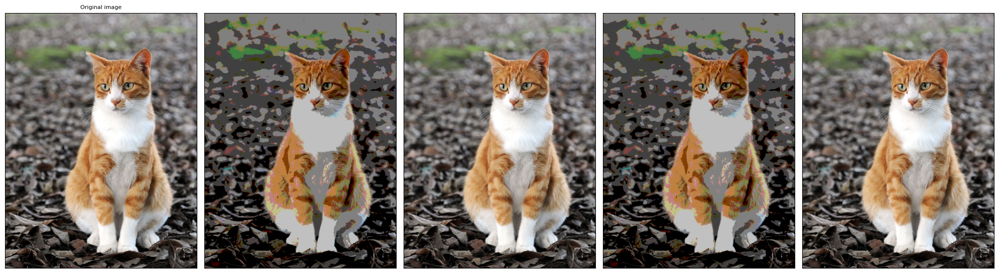

In [26]:
posterizer = T.RandomPosterize(bits=2)
posterized_imgs = [posterizer(orig_img) for _ in range(4)]
plot(posterized_imgs)

### RandomSolarize
`torchvision.transforms.RandomSolarize` 또는 `torchvision.transforms.functional.solarize`
>Theshold 이상의 값들을 반전시키는 solarize 변환한다.
>확률을 설정하지 않으면 0.5를 사용한다.
>
> 인자 (argument)
>    - threshold: solarize를 적용할 픽셀 값의 threshold
>    - p: solarize를 적용할 확률

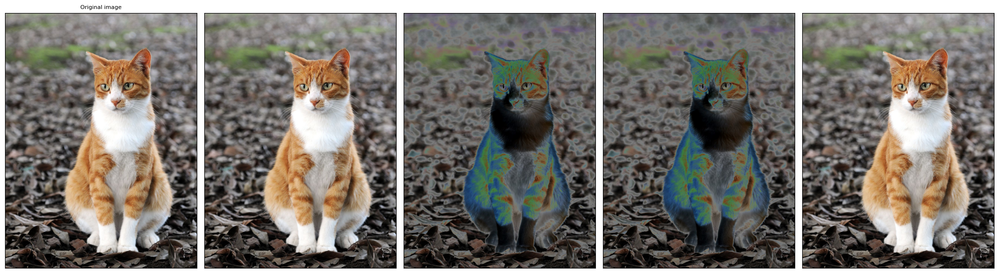

In [27]:
solarizer = T.RandomSolarize(threshold=128.0)
solarized_imgs = [solarizer(orig_img) for _ in range(4)]
plot(solarized_imgs)

### RandomAdjustSharpness
`torchvision.transforms.RandomAdjustSharpness` 또는 `torchvision.transforms.functional.adjust_sharpness`
> 이미지의 선명도를 랜덤하게 조정한다.
> 확률을 설정하지 않으면 0.5를 사용한다.\
> 엣지와 디테일이 더 뚜렷해지는 효과.\
> 인자 (argument)
>    - sharpness_factor: 얼마나 sharpness를 조절할지에 대한 값
>        - 0: blurred image
>        - 1: 원본 이미지
>        - 1초과: sharpness를 증가시킨 이미지
>    - p: sharpness 조절을 적용하는지에 대한 확률

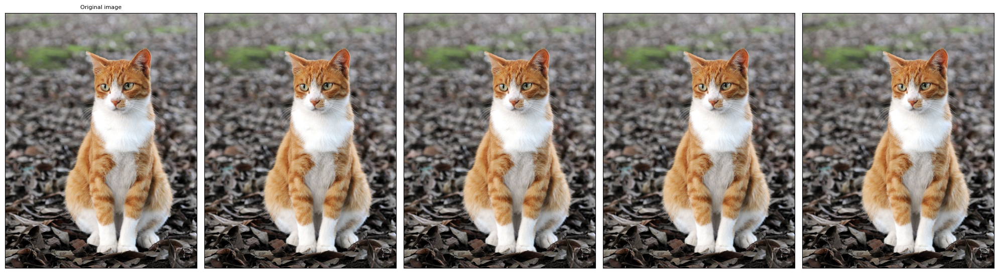

In [28]:
sharpness_adjuster = T.RandomAdjustSharpness(sharpness_factor=2)
sharpened_imgs = [sharpness_adjuster(orig_img) for _ in range(4)]
plot(sharpened_imgs)

### RandomAutocontrast
`torchvision.transforms.RandomAutocontrast` 또는 `torchvision.transforms.functional.autocontrast`
> 이미지에 랜덤하게 autocontrast를 적용.\
> 확률을 설정하지 않으면 0.5를 사용한다.\
> 이미지의 히스토그램을 자동으로 조정하여 전체적인 대비 향상. (어두운 영역 더 어둡게, 밝은 영역 더 밝게)\
> 인자 (argument)
>    - p: Autocontrast를 적용하는지에 대한 확률

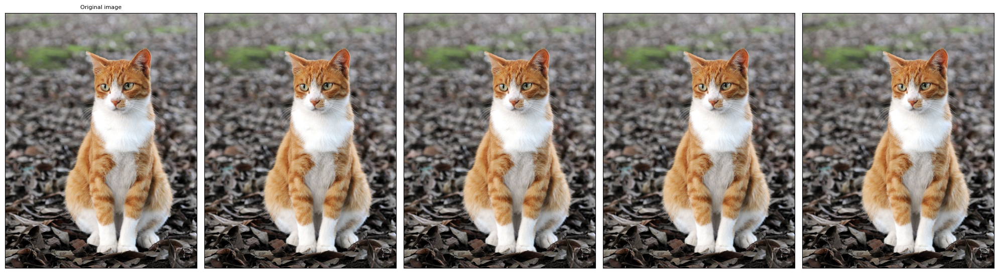

In [30]:
autocontraster = T.RandomAutocontrast(p=0.5)
autocontrasted_imgs = [autocontraster(orig_img) for _ in range(4)]
plot(autocontrasted_imgs)

### RandomEqualize
`torchvision.transforms.RandomEqualize` 또는 `torchvision.transforms.functional.equalize`
> 이미지의 히스토그램을 equalize 한다.\
> 이미지의 명암 분포를 균일하게 만들어 대비를 개선하는 효과.\
> 확률을 설정하지 않으면 0.5를 사용한다.
>
> 인자 (argument)
>    - p: Equalize를 적용하는지에 대한 확률

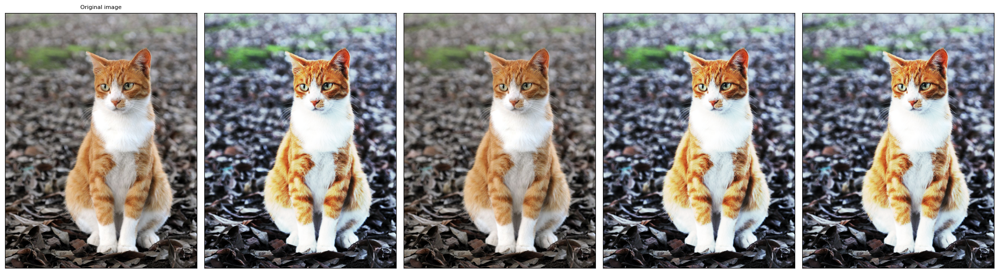

In [31]:
equalizer = T.RandomEqualize()
equalized_imgs = [equalizer(orig_img) for _ in range(4)]
plot(equalized_imgs)

## Randomly-applied transforms
> 아래의 transforms들은 일정한 확률 ``p``를 주어 transform이 일어날 확률을 조절할 수 있음

### RandomHorizontalFlip
`torchvision.transforms.RandomHorizontalFlip` 또는 `torchvision.transforms.functional.hflip`
> 확률이 주어졌을 때, 해당 확률에 따라 이미지를 좌우반전을 한다.


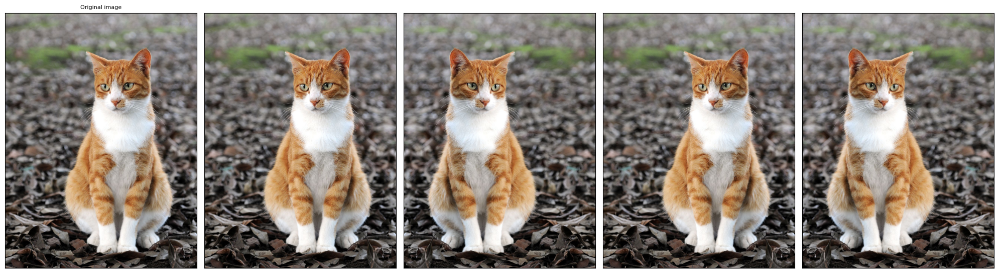

In [32]:
hflipper = T.RandomHorizontalFlip(p=0.5)
transformed_imgs = [hflipper(orig_img) for _ in range(4)]
plot(transformed_imgs)

### RandomVerticalFlip
`torchvision.transforms.RandomVerticalFlip` 또는 `torchvision.transforms.functional.vflip`
> 주어진 확률에 따라 이미지를 상하 반전을 한다.

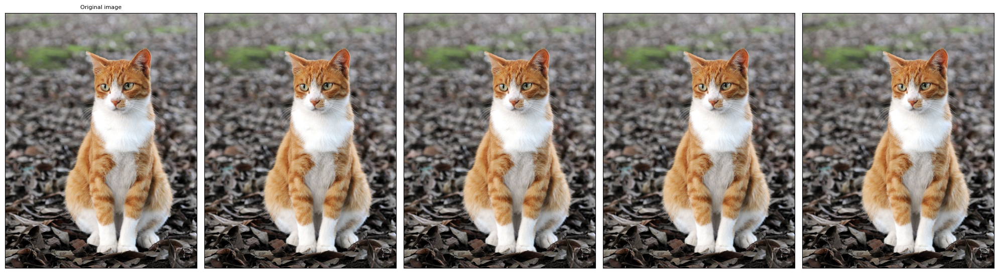

In [33]:
vflipper = T.RandomVerticalFlip(p=0.5)
transformed_imgs = [vflipper(orig_img) for _ in range(4)]
plot(transformed_imgs)

### RandomApply
`torchvision.transforms.RandomApply`
> 확률이 주어졌을 때 해당 확률에 따라 랜덤하게 transforms를 적용한다.


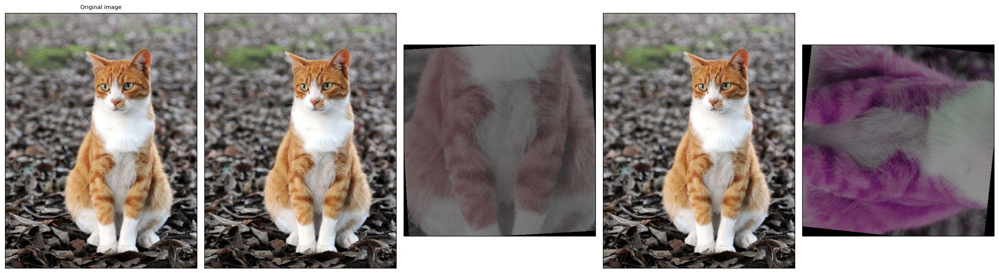

In [35]:
applier = T.RandomApply(
    transforms=[
        T.RandomCrop(size=(512, 512)),
        T.ColorJitter(brightness=0.5, contrast=0.5, saturation=0.5, hue=0.5),
        T.RandomHorizontalFlip(),
        T.RandomVerticalFlip(),
        T.RandomRotation(degrees=(0, 180))
    ],
    p=0.5
)
transformed_imgs = [applier(orig_img) for _ in range(4)]
plot(transformed_imgs)

## augmentation 고민없이 해보자. 자동화

### AutoAugment
`torchvision.transforms.AutoAugment`
> 자동으로 auto-augmentation 규칙에 따라 이미지 augmentation을 진행한다.\
> 가장 효과적인 데이터 증강 정책을 자동으로 찾아내는 방법.\
> 데이터 증강을 최적화하는 과정을 자동화하여, 사람의 개입 없이도 최적의 증강 전략. 하지만, 복잡한 검색 과정이 들어감.\
> `torchvision.transforms.AutoAugmentPolicy`를 통해 auto-augmentation 규칙을 확인할 수 있다.

> AutoAugment: Learning Augmentation Strategies from Data" <https://arxiv.org/pdf/1805.09501.pdf>`



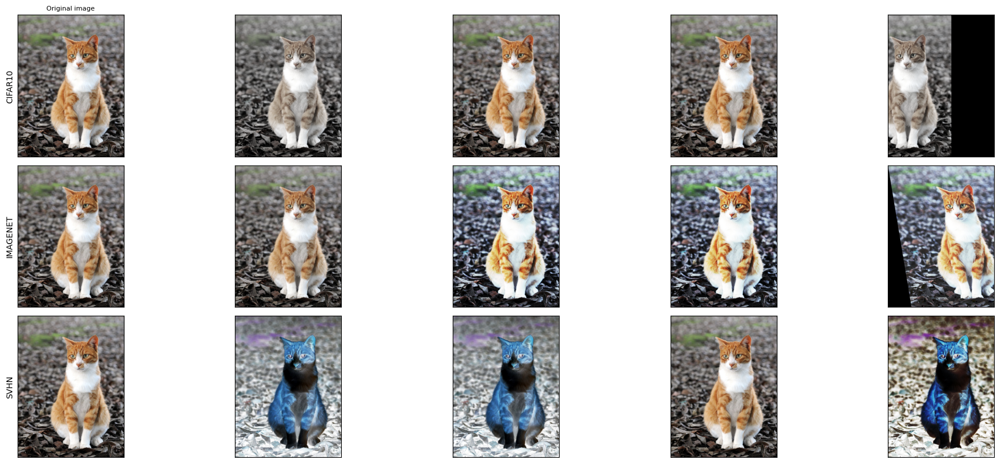

In [36]:
# CIFAR10, ImageNet, SVHN 데이터셋에 최적화된 정책들 로드.
policies = [T.AutoAugmentPolicy.CIFAR10, T.AutoAugmentPolicy.IMAGENET, T.AutoAugmentPolicy.SVHN]

augmenters = [T.AutoAugment(policy) for policy in policies]
imgs = [
    [augmenter(orig_img) for _ in range(4)]
    for augmenter in augmenters
]
row_title = [str(policy).split('.')[-1] for policy in policies]
plot(imgs, row_title=row_title)

### RandAugment
`torchvision.transforms.RandAugment`
> 자동으로 랜덤하게 이미지를 변환한다. \
> AutoAugment의 복잡성을 줄이고 사용 편의성을 높이기 위해\
> RandAugment: Practical automated data augmentation with a reduced search space" https://arxiv.org/abs/1909.13719

In [37]:
augmenter = T.RandAugment()
imgs = [augmenter(orig_img) for _ in range(4)]
plot(imgs)

Output hidden; open in https://colab.research.google.com to view.

### TrivialAugmentWide
`torchvision.transforms.TrivialAugmentWide` transform
> 자동으로 랜덤하게 이미지를 변환한다.\
> 단순하고 직관적인 방법으로, 여러 가지 증강 기법 중 무작위로 하나를 선택\
> TrivialAugment: Tuning-free Yet State-of-the-Art Data Augmentation" <https://arxiv.org/abs/2103.10158>


In [38]:
augmenter = T.TrivialAugmentWide()
imgs = [augmenter(orig_img) for _ in range(4)]
plot(imgs)

Output hidden; open in https://colab.research.google.com to view.